### This Jupyter notebook demonstrates how to load, mosaic, and visualize OPERA RTC-S1 data

In [1]:
# Data ETL imports
import numpy as np
import glob
import rioxarray

# GIS imports
import shapely.wkt as wkt
import rasterio
from rasterio.transform import from_origin
from rasterio.merge import merge
from rasterio.plot import show, show_hist
import folium
from folium import plugins
from rtc_utils import getbasemaps
import geopandas as gpd

# Plotting imports
import matplotlib as mpl
import matplotlib.pyplot as plt

# Misc imports
from pathlib import Path
import sys
sys.path.append('../../')

import warnings
warnings.filterwarnings('ignore')

import os
os.environ["AWS_NO_SIGN_REQUEST"] = "YES"

##### The sample data used here is made available via OPERA's AWS S3 bucket. Users can downlaoad data from the ASF DAAC in the future and replace the below links with local paths.

In [2]:
# Path to VV burst files. This can either be a publicly accessible URL or a local path
burst1 = "s3://opera-pst-rs-pop1/products/RTC_S1/OPERA_L2_RTC-S1_T071-151231-IW1_20210418T135207Z_20230528T032526Z_S1B_30_v0.0/OPERA_L2_RTC-S1_T071-151231-IW1_20210418T135207Z_20230528T032526Z_S1B_30_v0.0_VV.tif"
burst2 = "s3://opera-pst-rs-pop1/products/RTC_S1/OPERA_L2_RTC-S1_T071-151230-IW1_20210418T135205Z_20230528T032526Z_S1B_30_v0.0/OPERA_L2_RTC-S1_T071-151230-IW1_20210418T135205Z_20230528T032526Z_S1B_30_v0.0_VV.tif"
burst3 = "s3://opera-pst-rs-pop1/products/RTC_S1/OPERA_L2_RTC-S1_T071-151229-IW1_20210418T135202Z_20230528T032526Z_S1B_30_v0.0/OPERA_L2_RTC-S1_T071-151229-IW1_20210418T135202Z_20230528T032526Z_S1B_30_v0.0_VV.tif"

# Create a list of filepaths
fullPath_VV_20210418_IW1 = [burst1, burst2, burst3]

In [3]:
# Path to VH burst files.
burst1 = "s3://opera-pst-rs-pop1/products/RTC_S1/OPERA_L2_RTC-S1_T071-151231-IW1_20210418T135207Z_20230528T032526Z_S1B_30_v0.0/OPERA_L2_RTC-S1_T071-151231-IW1_20210418T135207Z_20230528T032526Z_S1B_30_v0.0_VH.tif"
burst2 = "s3://opera-pst-rs-pop1/products/RTC_S1/OPERA_L2_RTC-S1_T071-151230-IW1_20210418T135205Z_20230528T032526Z_S1B_30_v0.0/OPERA_L2_RTC-S1_T071-151230-IW1_20210418T135205Z_20230528T032526Z_S1B_30_v0.0_VH.tif"
burst3 = "s3://opera-pst-rs-pop1/products/RTC_S1/OPERA_L2_RTC-S1_T071-151229-IW1_20210418T135202Z_20230528T032526Z_S1B_30_v0.0/OPERA_L2_RTC-S1_T071-151229-IW1_20210418T135202Z_20230528T032526Z_S1B_30_v0.0_VH.tif"

# Create a list of filepaths
fullPath_VH_20210418_IW1 = [burst1, burst2, burst3]

### Read raster metadata

In [4]:
# Read a sample profile and CRS for future use
with rasterio.open(burst1) as src:
    burst_profile = src.profile
    burst_crs = src.crs

### Merge RTC-S1 bursts

In [5]:
# merge rasters
# switch merge method to 'last' if data gaps are present in the final mosaic
mosaic_VV_20210418, transform_VV_20210418 = merge(fullPath_VV_20210418_IW1, nodata=np.nan, method='first')
mosaic_VH_20210418, transform_VH_20210418 = merge(fullPath_VH_20210418_IW1, nodata=np.nan, method='first')

# clip backscatter values to [0, 1]
mosaic_VV_20210418 = np.clip(mosaic_VV_20210418, 0, 1)
mosaic_VH_20210418 = np.clip(mosaic_VH_20210418, 0, 1)

### Convert backscatter from linear scale to decibels

In [6]:
# Convert rasters to dB scale to help compress dynamic range
mosaic_VV_20210418_db = np.clip(10*np.log10(mosaic_VV_20210418), -27, 0)
mosaic_VH_20210418_db = np.clip(10*np.log10(mosaic_VH_20210418), -27, 0)

### Visualize backscatter

Typically, specular reflections of radar signals on smooth surfaces result in low backscatter (dark pixels) regions as the targets reflects the signals away from the SAR satellite, while diffuse scattering from surfaces exhibiting roughness at the same scale as the radar wavelength results in more backscatter (light pixels).

Thus, targets such as open surface water and paved roads appear dark in the images, while vegetation and urban areas can appear as bright regions 

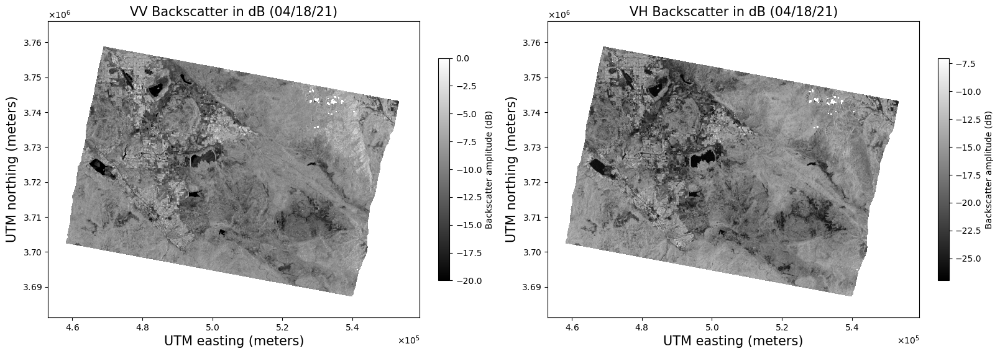

In [7]:
# visualize mosaics
fig, ax = plt.subplots(1, 2, figsize=(16, 8), layout='constrained')

im = ax[0].imshow(mosaic_VV_20210418_db[0], cmap='gray',vmin=-20,vmax=0) # imshow to setup plot
# rasterio.show is preferable for visualization as it correctly sets axes extents
show(mosaic_VV_20210418_db[0],vmin=-20,vmax=0, cmap='gray', transform=transform_VV_20210418, ax=ax[0]) 

ax[0].set_title("VV Backscatter in dB (04/18/21)", fontsize=15)
ax[0].set_xlabel('UTM easting (meters)',fontsize=15)
ax[0].set_ylabel('UTM northing (meters)',fontsize=15)
ax[0].ticklabel_format(axis='both', style='scientific',scilimits=(0,0),useOffset=False,useMathText=True)

cbar = plt.colorbar(im, ax=ax[0], fraction=0.03)
cbar.set_label('Backscatter amplitude (dB)', fontsize=10)
cbar.ax.tick_params(labelsize=10)

im = ax[1].imshow(mosaic_VH_20210418_db[0], cmap='gray',vmin=-27,vmax=-7)
show(mosaic_VH_20210418_db[0],vmin=-27,vmax=-7, cmap='gray', transform=transform_VH_20210418, ax=ax[1])

ax[1].set_title("VH Backscatter in dB (04/18/21)", fontsize=15)
ax[1].set_xlabel('UTM easting (meters)',fontsize=15)
ax[1].set_ylabel('UTM northing (meters)',fontsize=15)
ax[1].ticklabel_format(axis='both', style='scientific',scilimits=(0,0),useOffset=False,useMathText=True)

cbar = plt.colorbar(im, ax=ax[1], fraction=0.03)
cbar.set_label('Backscatter amplitude (dB)', fontsize=10)
cbar.ax.tick_params(labelsize=10)

In [8]:
# Helper function to scale image pixel values to [0, 1]
def scale(img):
    img[np.isinf(img)] = np.nan
    return (img - np.nanmin(img))/(np.nanmax(img)-np.nanmin(img))

### False color images
SAR data can be visualized as false color RGB images. In this case, we use the VV, VH and VV/VH data as our red, blue and green channels respectively. The false color images do not have any physical interpretation, but serve to highlight backscatter in various polarizations, or the difference in backscatter between polarizations

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


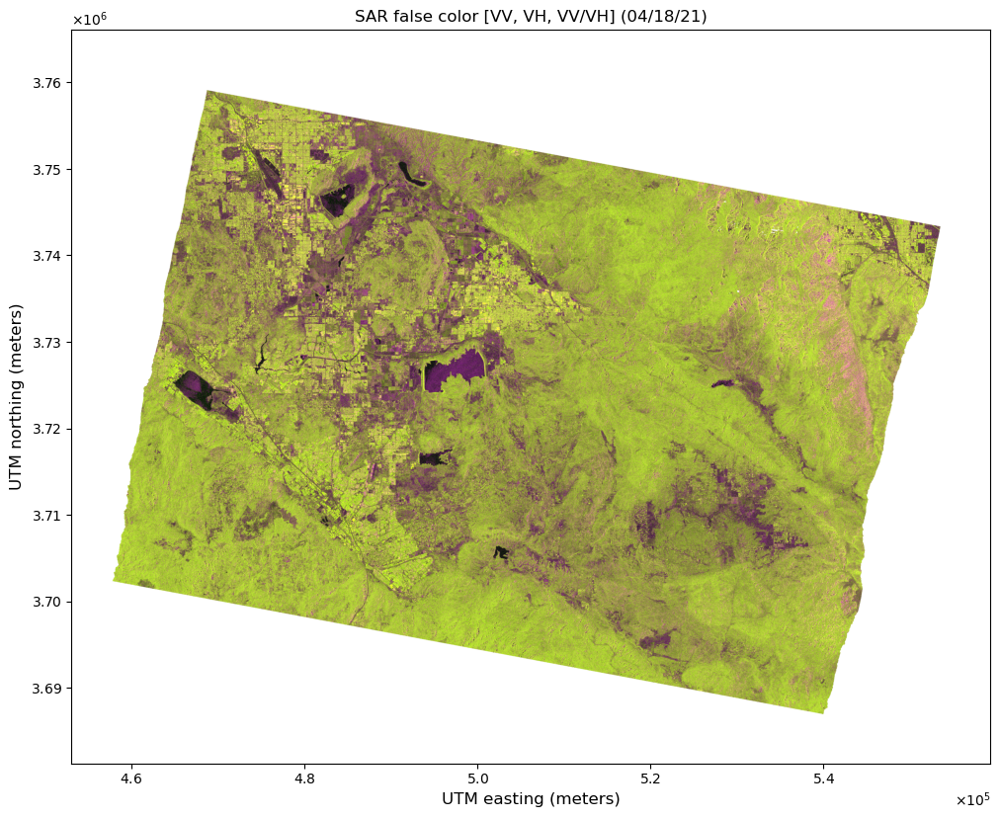

In [9]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))

ch_1 = scale(mosaic_VV_20210418_db)
ch_2 = scale(mosaic_VH_20210418_db)
backscatter_falsecolor = np.concatenate([ch_1, 1.5*ch_2+0.2*scale(ch_1-ch_2), ch_1-ch_2])

# replace NaNs values
backscatter_falsecolor[np.isnan(backscatter_falsecolor)] = 1

show(backscatter_falsecolor, transform=transform_VV_20210418, ax=ax)

ax.set_title("SAR false color [VV, VH, VV/VH] (04/18/21)", fontsize=12)
ax.set_xlabel('UTM easting (meters)',fontsize=12)
ax.set_ylabel('UTM northing (meters)',fontsize=12)
ax.ticklabel_format(axis='both', style='scientific',scilimits=(0,0),useOffset=False,useMathText=True)

Text(0.5, 0, 'Backscatter (dB)')

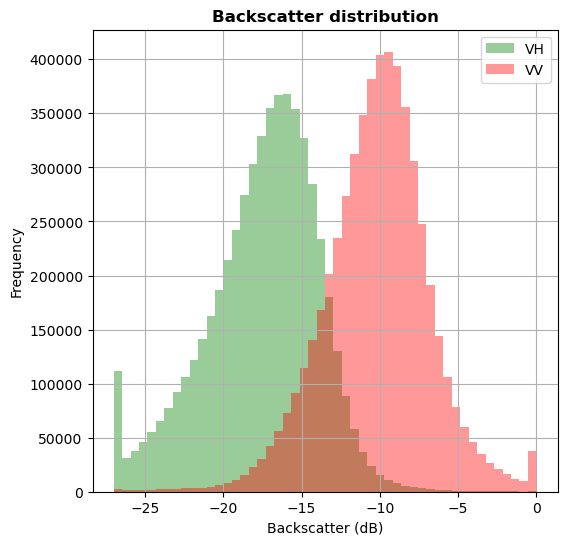

In [10]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

backscatter_falsecolor = np.clip(np.concatenate([mosaic_VV_20210418_db, mosaic_VH_20210418_db]), -30, 0)

show_hist(backscatter_falsecolor, bins=50, alpha=0.4, stacked=False, histtype='stepfilled', title="Backscatter distribution", label = ['VV', 'VH'], ax=ax)
ax.set_xlabel("Backscatter (dB)")

#### Save merged rasters locally

In [11]:
# location for saved rasters
output_path = Path("../data")
output_path.mkdir(exist_ok=True, parents=True)
mosaic_profile = burst_profile.copy()

In [12]:
# Saving VH backscatter mosaics

# save backscatter in linear units
output_file = output_path / "OPERA_RTC-S1_VH_20210418_linear.tif"

mosaic_profile.update({"driver": "GTiff",
                    "height": mosaic_VH_20210418.shape[1],
                    "width": mosaic_VH_20210418.shape[2],
                    "transform": transform_VH_20210418,
                    "nodata": np.nan})

# Write the merged GeoTIFF to the output file
with rasterio.open(output_file, "w", **mosaic_profile) as dest:
    dest.write(mosaic_VH_20210418)

# save backscatter in dB units
output_file = output_path / "OPERA_RTC-S1_VH_20210418_db.tif"
# Write the merged GeoTIFF to the output file
with rasterio.open(output_file, "w", **mosaic_profile) as dest:
    dest.write(mosaic_VH_20210418_db)

In [13]:
# Saving VV backscatter mosaics

# save backscatter in linear units
output_file = output_path / "OPERA_RTC-S1_VV_20210418_linear.tif"

mosaic_profile.update({"driver": "GTiff",
                    "height": mosaic_VV_20210418.shape[1],
                    "width": mosaic_VV_20210418.shape[2],
                    "transform": transform_VV_20210418,
                    "nodata": np.nan})

# Write the merged GeoTIFF to the output file
with rasterio.open(output_file, "w", **mosaic_profile) as dest:
    dest.write(mosaic_VV_20210418)

# save backscatter in dB units
output_file = output_path / "OPERA_RTC-S1_VV_20210418_db.tif"
# Write the merged GeoTIFF to the output file
with rasterio.open(output_file, "w", **mosaic_profile) as dest:
    dest.write(mosaic_VV_20210418_db)

### Let us visualize the backscatter on an interactive Folium map

In [14]:
# helper function for folium visualization
def colorize(array=[], cmap='RdBu', cmin=[], cmax=[]):
    normed_data = (array - cmin) / (cmax - cmin)    
    cm = plt.cm.get_cmap(cmap)
    return cm(normed_data) 

#### Preparing arrays for Folium

In [15]:
# Read the merged raster file
# we will have two layers in our folium visualization with different colorbars

output_file = output_path / "OPERA_RTC-S1_VV_20210418_db.tif"
src1 = rioxarray.open_rasterio(output_file)
merged_ifg = src1.rio.reproject("EPSG:4326")[0]             # Folium maps are in EPSG:4326
minlon,minlat,maxlon,maxlat = merged_ifg.rio.bounds()
new_bbox = [minlon, maxlon, minlat, maxlat]

# Conversion for folium visualization and attach RGBA color to numpy array
src1 = colorize(merged_ifg, 'gray', -20, -0)

# Read the merged raster file
output_file = output_path / "OPERA_RTC-S1_VH_20210418_db.tif"
src2 = rioxarray.open_rasterio(output_file)
merged_ifg = src2.rio.reproject("EPSG:4326")[0]             # Folium maps are in EPSG:4326
minlon,minlat,maxlon,maxlat = merged_ifg.rio.bounds()
new_bbox = [minlon, maxlon, minlat, maxlat]

# Conversion for folium visualization and attach RGBA color to numpy array
src2 = colorize(merged_ifg, 'gray', -26, -7)

output_file = output_path / "OPERA_RTC-S1_VV_20210418_db.tif"
src3 = rioxarray.open_rasterio(output_file)
merged_ifg = src3.rio.reproject("EPSG:4326")[0]             # Folium maps are in EPSG:4326
minlon,minlat,maxlon,maxlat = merged_ifg.rio.bounds()
new_bbox = [minlon, maxlon, minlat, maxlat]

# Conversion for folium visualization and attach RGBA color to numpy array
src3 = colorize(merged_ifg, 'bwr', -20, -0)


#### Generate Folium map


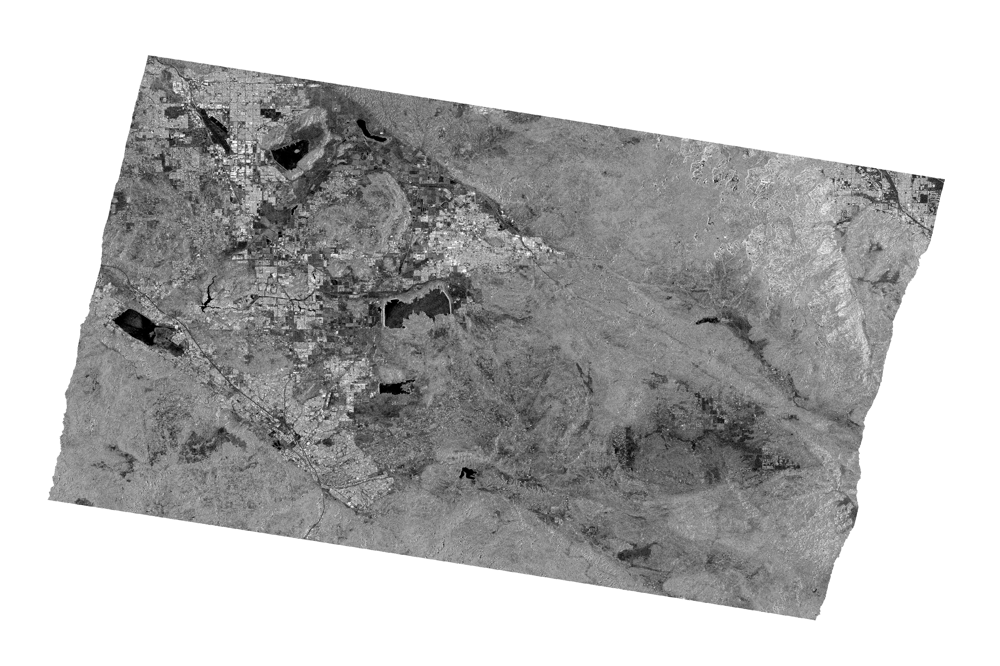
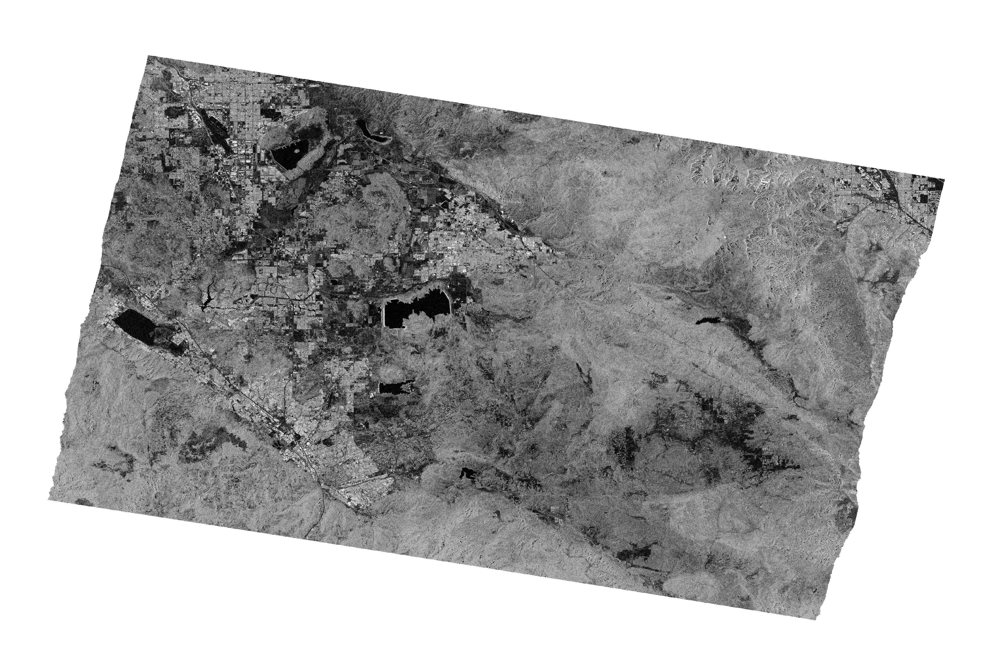
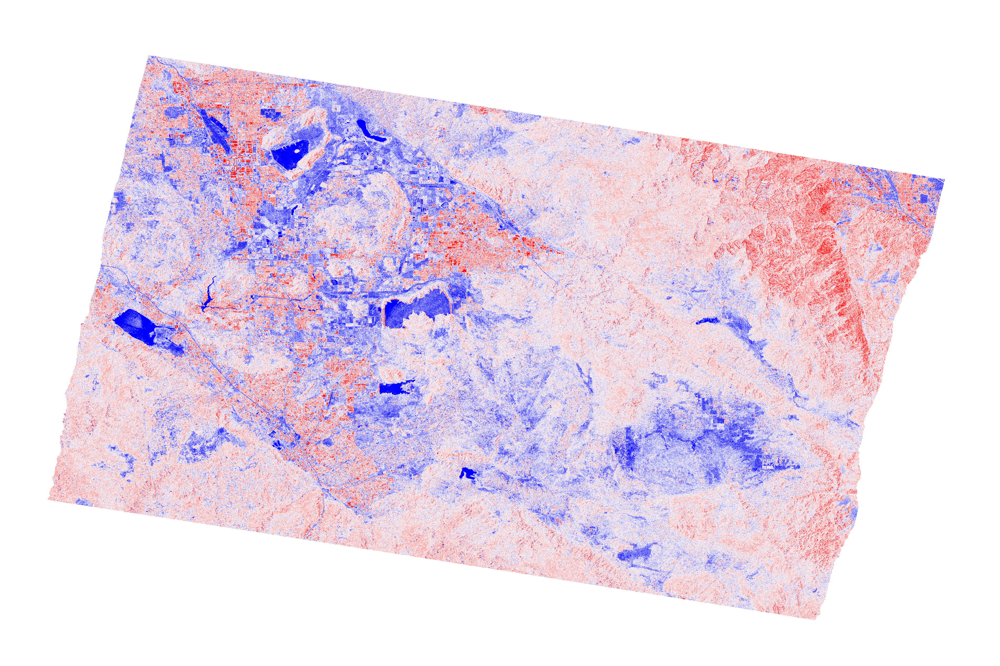

In [16]:
# Overlay merged bursts onto a basemap.
# Initialize Folium basemap and define center of mapview
xmid =(new_bbox[0]+new_bbox[1])/2 ; ymid = (new_bbox[2]+new_bbox[3])/2
m = folium.Map(location=[ymid, xmid], zoom_start=9, tiles='Stamen Terrain', show=True)

# Add custom basemaps
basemaps = getbasemaps()
for basemap in basemaps:
    basemaps[basemap].add_to(m)


# Include mosaics as layers

# Colorized backscatter
folium.raster_layers.ImageOverlay(src1, 
                                        opacity=1, 
                                        bounds=[[new_bbox[2],new_bbox[0]],[new_bbox[3],new_bbox[1]]],
                                        interactive=False,
                                        name='VV backscatter (dB)',
                                        show=True).add_to(m)

# Backscatter in grayscale
folium.raster_layers.ImageOverlay(src2, 
                                        opacity=1, 
                                        bounds=[[new_bbox[2],new_bbox[0]],[new_bbox[3],new_bbox[1]]],
                                        interactive=False,
                                        name='VH backscatter (db)',
                                        show=True).add_to(m)
                                        
# Backscatter in grayscale
folium.raster_layers.ImageOverlay(src3, 
                                        opacity=0.7, 
                                        bounds=[[new_bbox[2],new_bbox[0]],[new_bbox[3],new_bbox[1]]],
                                        interactive=False,
                                        name='VV backscatter (db) (colorized)',
                                        show=True).add_to(m)

#layer Control
m.add_child(folium.LayerControl())

# Add fullscreen button
plugins.Fullscreen().add_to(m)

#Add inset minimap image
minimap = plugins.MiniMap(width=150, height=150)
m.add_child(minimap)

#Mouse Position
fmtr = "function(num) {return L.Util.formatNum(num, 3) + ' º ';};"
plugins.MousePosition(position='bottomright', separator=' | ', prefix="Lat/Lon:",
                     lat_formatter=fmtr, lng_formatter=fmtr).add_to(m)

m